In [1]:
import os
import glob as glob
import matplotlib.pyplot as plt
import cv2
import requests
import random
import numpy as np

In [2]:
np.random.seed(42)

In [3]:
TRAIN = True
# Number of epochs to train for.
EPOCHS = 5

In [4]:
# Make changes to class_names list according to the dataset
class_names = ['DotPeeningText', 'MachinePeeningText']
colors = np.random.uniform(0, 255, size=(len(class_names), 3))

In [5]:
# Function to convert bounding boxes in YOLO format to xmin, ymin, xmax, ymax.
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [6]:
def plot_box(image, bboxes, labels):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    h, w, _ = image.shape
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*w)
        ymin = int(y1*h)
        xmax = int(x2*w)
        ymax = int(y2*h)
        width = xmax - xmin
        height = ymax - ymin
        
        class_name = class_names[int(labels[box_num])]
        
        cv2.rectangle(
            image, 
            (xmin, ymin), (xmax, ymax),
            color=colors[class_names.index(class_name)],
            thickness=2
        ) 

        font_scale = min(1,max(3,int(w/500)))
        font_thickness = min(2, max(10,int(w/50)))
        
        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))
        # Text width and height
        tw, th = cv2.getTextSize(
            class_name, 
            0, fontScale=font_scale, thickness=font_thickness
        )[0]
        p2 = p1[0] + tw, p1[1] + -th - 10
        cv2.rectangle(
            image, 
            p1, p2,
            color=colors[class_names.index(class_name)],
            thickness=-1,
        )
        cv2.putText(
            image, 
            class_name,
            (xmin+1, ymin-10),
            cv2.FONT_HERSHEY_SIMPLEX,
            font_scale,
            (255, 255, 255),
            font_thickness
        )
    return image

In [7]:
# Function to plot images with the bounding boxes.
def plot(image_paths, label_paths, num_samples):
    all_training_images = glob.glob(image_paths)
    all_training_labels = glob.glob(label_paths)
    all_training_images.sort()
    all_training_labels.sort()
    
    num_images = len(all_training_images)
    
    plt.figure(figsize=(15, 12))
    for i in range(num_samples):
        j = random.randint(0,num_images-1)
        image = cv2.imread(all_training_images[j])
        with open(all_training_labels[j], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label = label_line[0]
                bbox_string = label_line[2:]
                x_c, y_c, w, h = bbox_string.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels)
        plt.subplot(2, 2, i+1)
        plt.imshow(result_image[:, :, ::-1])
        plt.axis('off')
    plt.subplots_adjust(wspace=0)
    plt.tight_layout()
    plt.show()

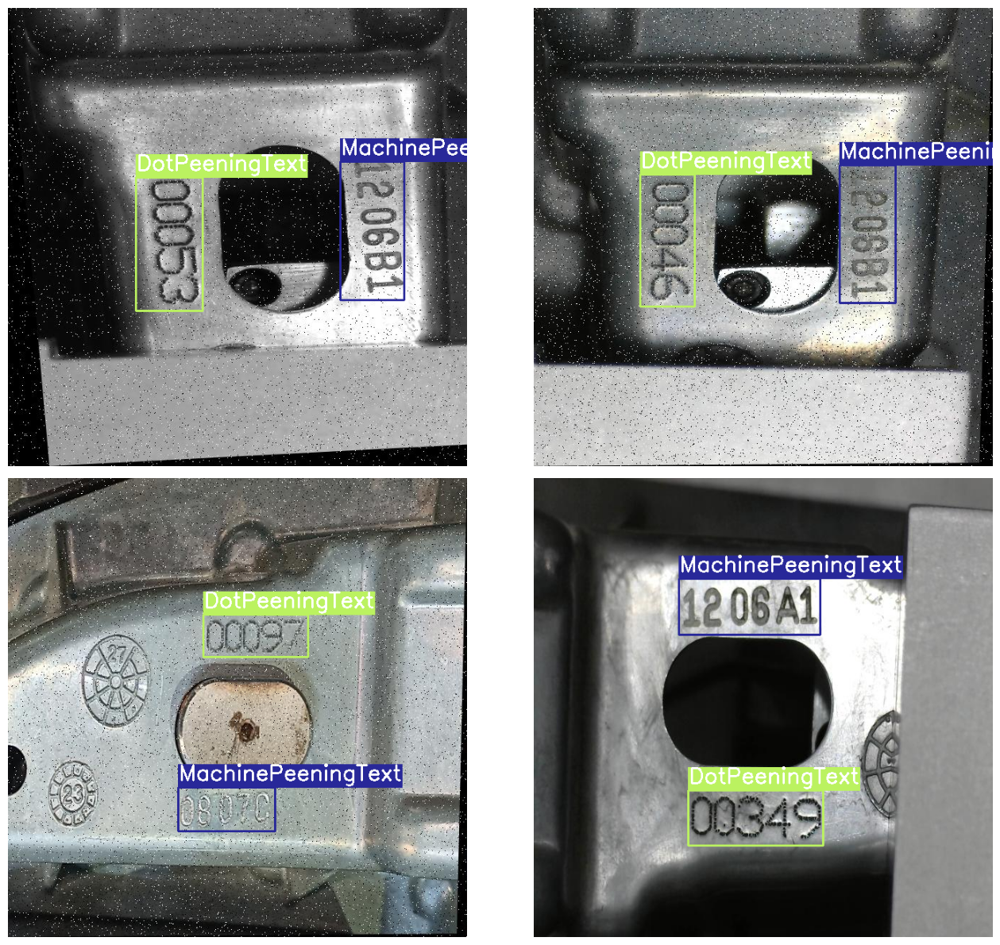

In [8]:
# Modify here accordingly to local directory
# Visualize a few training images.
plot(
    image_paths='D:/Code-Templates/YOLO/dataset/train/images/*', 
    label_paths='D:/Code-Templates/YOLO/dataset/train/labels/*',
    num_samples=4,
)

In [9]:
def set_res_dir():
    # Directory to store results
    res_dir_count = len(glob.glob('runs/train/*'))
    print(f"Current number of result directories: {res_dir_count}")
    if TRAIN:
        RES_DIR = f"results_{res_dir_count+1}"
        print(RES_DIR)
    else:
        RES_DIR = f"results_{res_dir_count}"
    return RES_DIR

In [10]:
def monitor_tensorboard():
    %load_ext tensorboard
    %tensorboard --logdir runs/train

In [11]:
%cd yolov5/
!cd

D:\Code-Templates\YOLO\yolov5
D:\Code-Templates\YOLO\yolov5


In [12]:
RES_DIR = set_res_dir()

Current number of result directories: 0
results_1


In [13]:
# Modify here accordingly to local directory
# Remember to make changes in data.yaml according to the local directory
# Model weights yolov5s works for my GTX1050Ti (4GB), should increase size according to GPU memory
if TRAIN:
    !python train.py --data D:/Code-Templates/YOLO/dataset/data.yaml --weights yolov5s.pt \
    --img 640 --epochs {EPOCHS} --batch-size 16 --name {RES_DIR} --patience 10

train: weights=yolov5s.pt, cfg=, data=D:/Code-Templates/YOLO/dataset/data.yaml, hyp=data\hyps\hyp.scratch-low.yaml, epochs=5, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs\train, name=results_1, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=10, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 
YOLOv5  v7.0-223-g005dcfa Python-3.8.18 torch-2.0.0 CUDA:0 (NVIDIA GeForce GTX 1050 Ti, 4096MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma

In [14]:
# Modify path for data and weights according to local directory
!python val.py --data D:/Code-Templates/YOLO/dataset/data.yaml --weights D:/Code-Templates/YOLO/yolov5/runs/train/results_1/weights/best.pt --img 640

val: data=D:/Code-Templates/YOLO/dataset/data.yaml, weights=['D:/Code-Templates/YOLO/yolov5/runs/train/results_1/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs\val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5  v7.0-223-g005dcfa Python-3.8.18 torch-2.0.0 CUDA:0 (NVIDIA GeForce GTX 1050 Ti, 4096MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs

val: Scanning D:\Code-Templates\YOLO\dataset\valid\labels.cache... 86 images, 0 backgrounds, 0 corrupt: 100%|##########| 86/86 [00:00<?, ?it/s]
val: Scanning D:\Code-Templates\YOLO\dataset\valid\labels.cache... 86 images, 0 backgrounds, 0 corrupt: 100%|##########| 86/86 [00:00<?, ?it/s]

                 Class     Images  Instances          P          R      mAP50   mAP50-95:   0%|          

In [15]:
# Function to show validation predictions saved during training.
def show_valid_results(RES_DIR):
    !ls runs/train/{RES_DIR}
    EXP_PATH = f"runs/train/{RES_DIR}"
    validation_pred_images = glob.glob(f"{EXP_PATH}/*_pred.jpg")
    print(validation_pred_images)
    for pred_image in validation_pred_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

In [16]:
# Helper function for inference on images.
def inference(RES_DIR, data_path):
    # Directory to store inference results.
    infer_dir_count = len(glob.glob('runs/detect/*'))
    print(f"Current number of inference detection directories: {infer_dir_count}")
    INFER_DIR = f"inference_{infer_dir_count+1}"
    print(INFER_DIR)
    # Inference on images.
    !python detect.py --weights runs/train/{RES_DIR}/weights/best.pt \
    --source {data_path} --name {INFER_DIR} --save-txt --save-conf
    return INFER_DIR

In [17]:
def visualize(INFER_DIR):
# Visualize inference images.
    INFER_PATH = f"runs/detect/{INFER_DIR}"
    infer_images = glob.glob(f"{INFER_PATH}/*.jpg")
    print(infer_images)
    for pred_image in infer_images:
        image = cv2.imread(pred_image)
        plt.figure(figsize=(19, 16))
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
        plt.show()

'ls' is not recognized as an internal or external command,
operable program or batch file.


['runs/train/results_1\\val_batch0_pred.jpg', 'runs/train/results_1\\val_batch1_pred.jpg', 'runs/train/results_1\\val_batch2_pred.jpg']


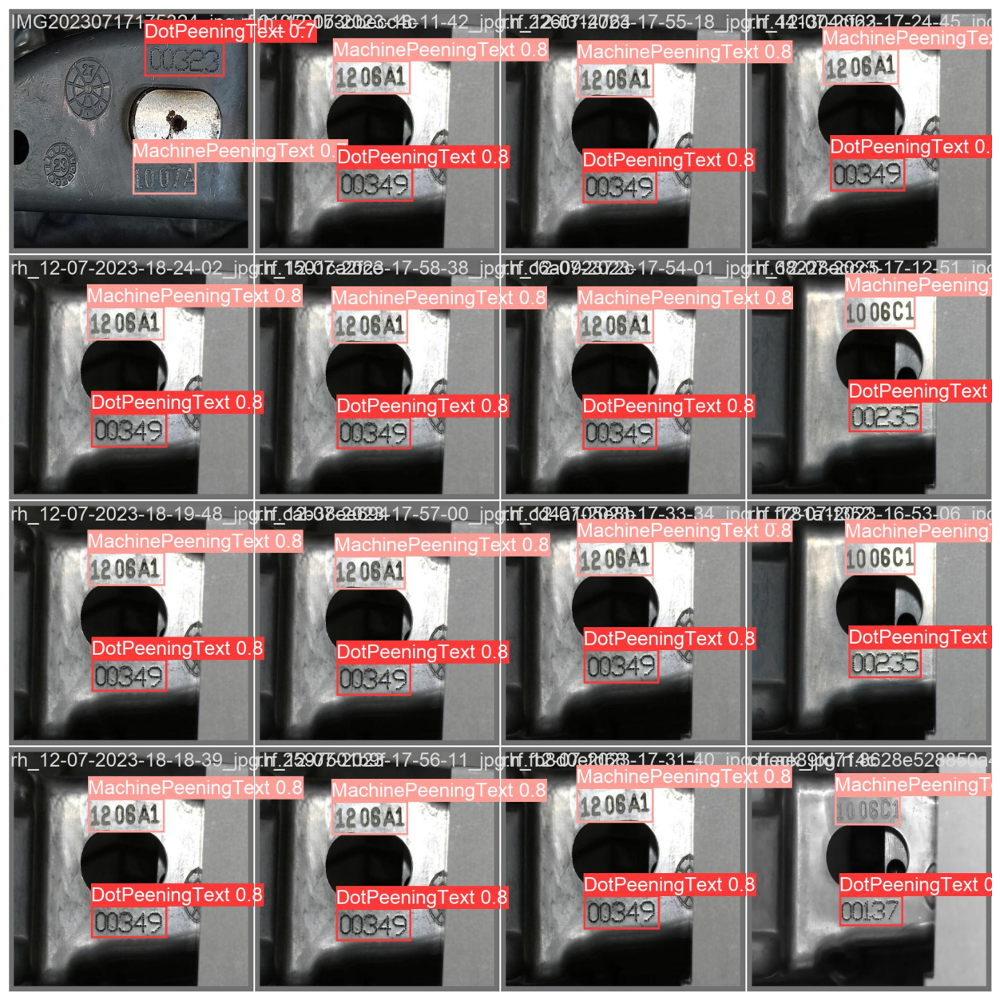

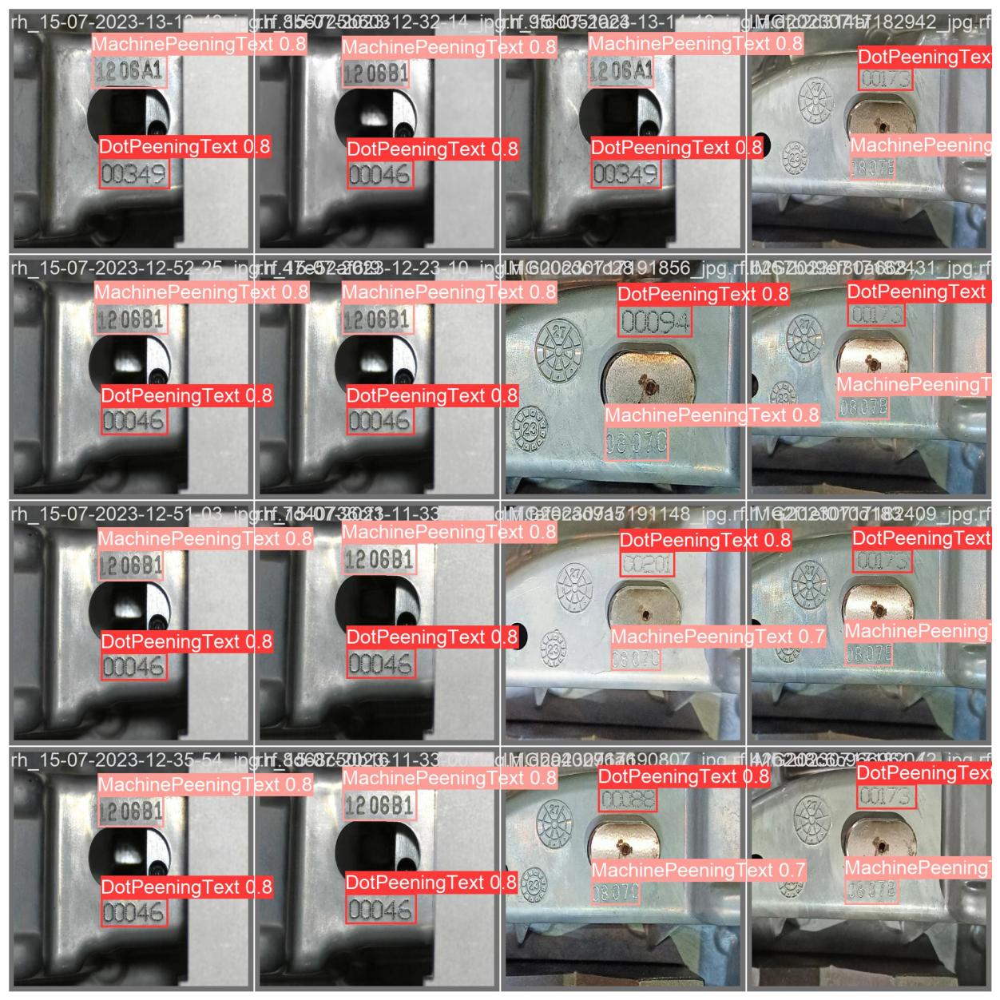

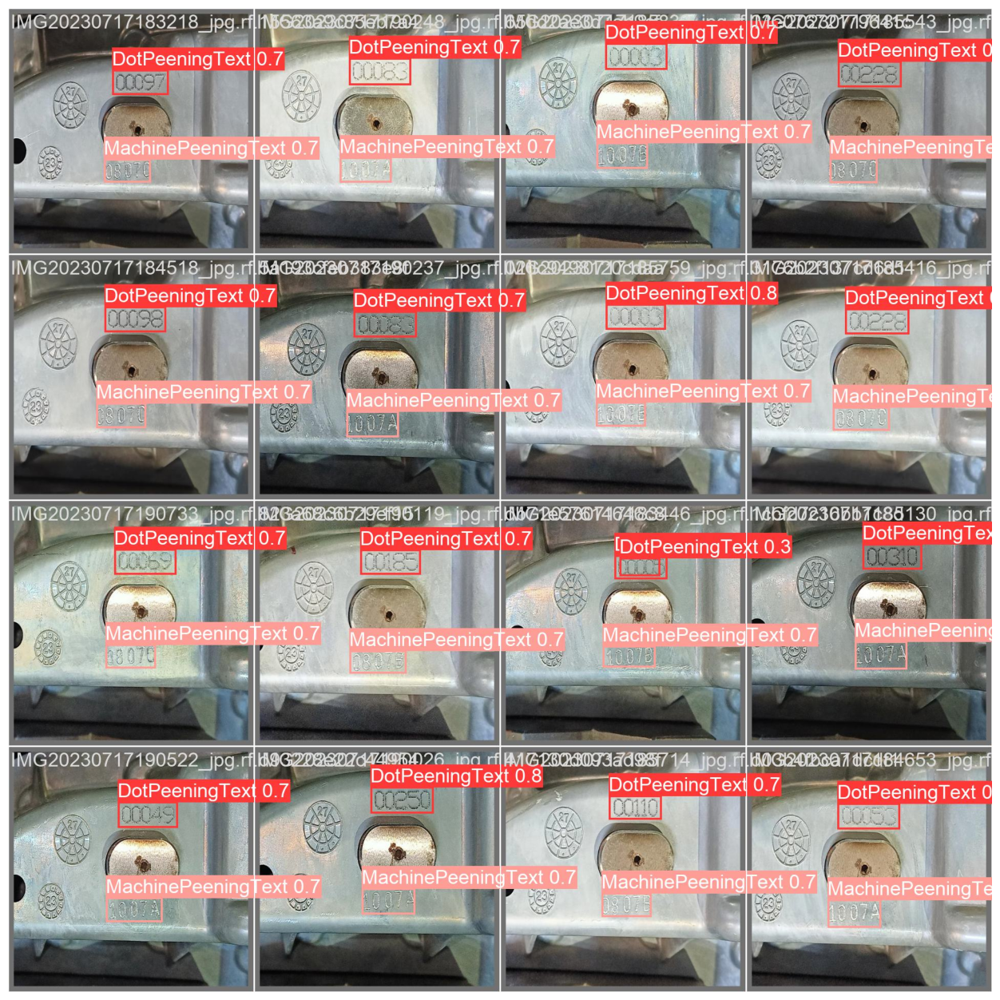

In [18]:
show_valid_results(RES_DIR)

In [19]:
# Can give a directory of folder of images here to check model on the images
IMAGE_INFER_DIR = inference(RES_DIR, 'D:/Upwork/KS/actual_cam/1006C1_00137/')

Current number of inference detection directories: 1
inference_2


detect: weights=['runs/train/results_1/weights/best.pt'], source=D:/Upwork/KS/actual_cam/1006C1_00137/, data=data\coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_csv=False, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs\detect, name=inference_2, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5  v7.0-223-g005dcfa Python-3.8.18 torch-2.0.0 CUDA:0 (NVIDIA GeForce GTX 1050 Ti, 4096MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/15 D:\Upwork\KS\actual_cam\1006C1_00137\check.jpg: 480x640 1 DotPeeningText, 1 MachinePeeningText, 34.0ms
image 2/15 D:\Upwork\KS\actual_cam\1006C1_00137\rh_15.07.2023,16.28.12.jpg: 480x640 1 DotPeeningText, 1 MachinePeeningText, 17.0ms
image 3/15 D:\Upwork\KS\actual_cam\1006C1_0013

['runs/detect/inference_2\\check.jpg', 'runs/detect/inference_2\\rh_15.07.2023,16.28.12.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.38.51.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.39.22.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.40.23.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.40.51.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.41.35.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.42.00.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.43.41.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.44.13.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.44.59.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.46.00.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.46.33.jpg', 'runs/detect/inference_2\\rh_15.07.2023,17.47.02.jpg', 'runs/detect/inference_2\\rh_15.07.2023,18.35.35.jpg']


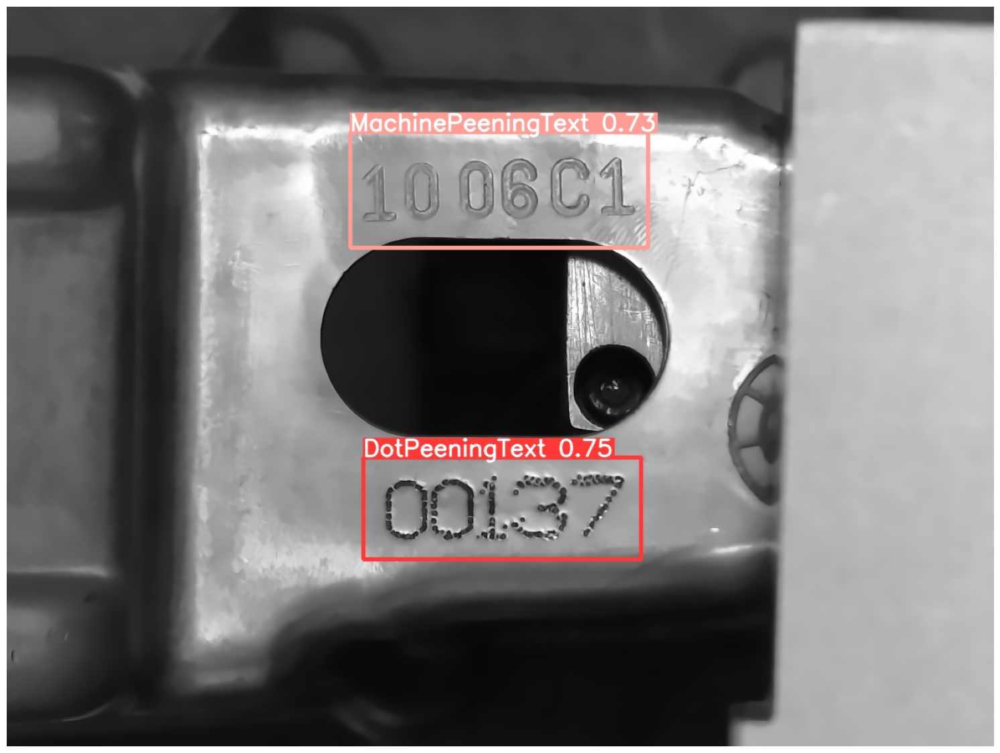

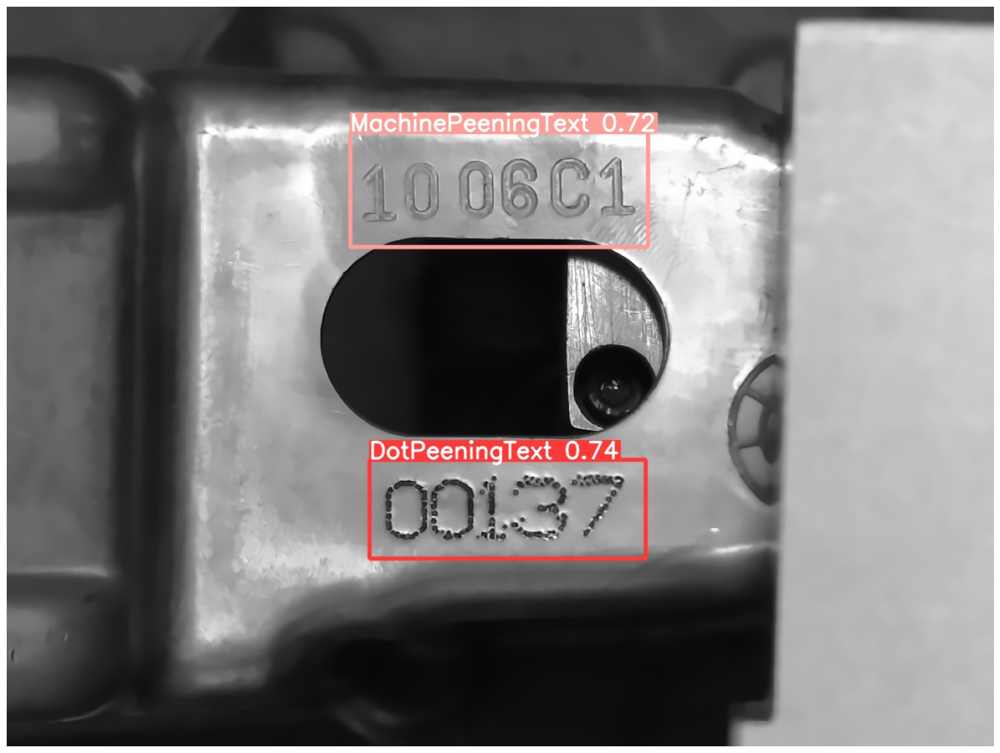

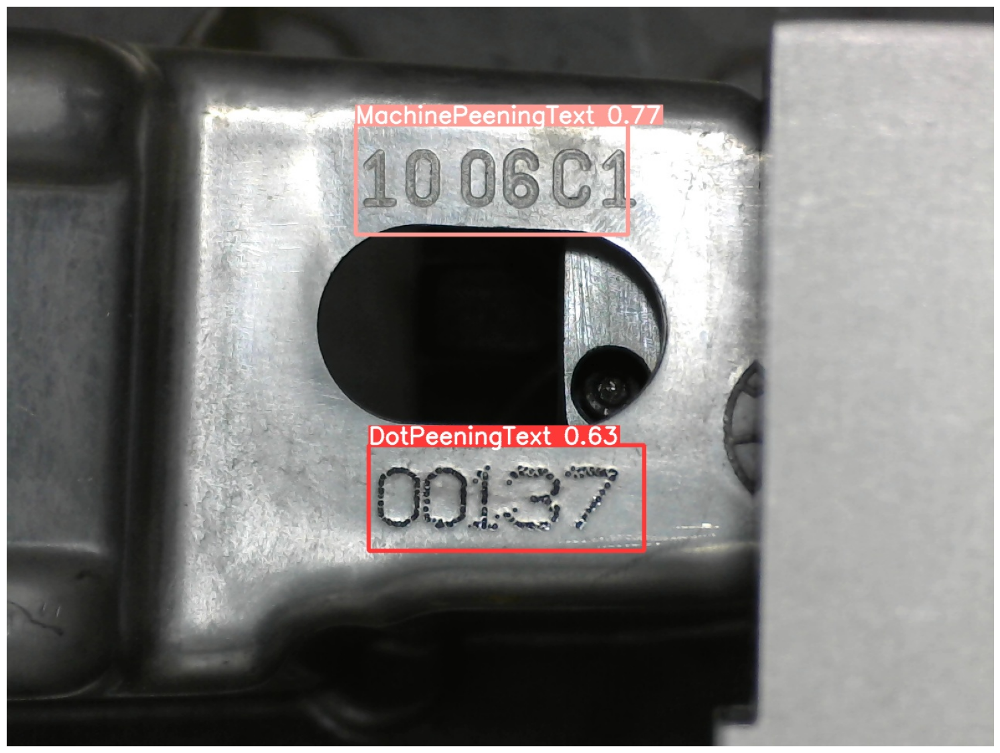

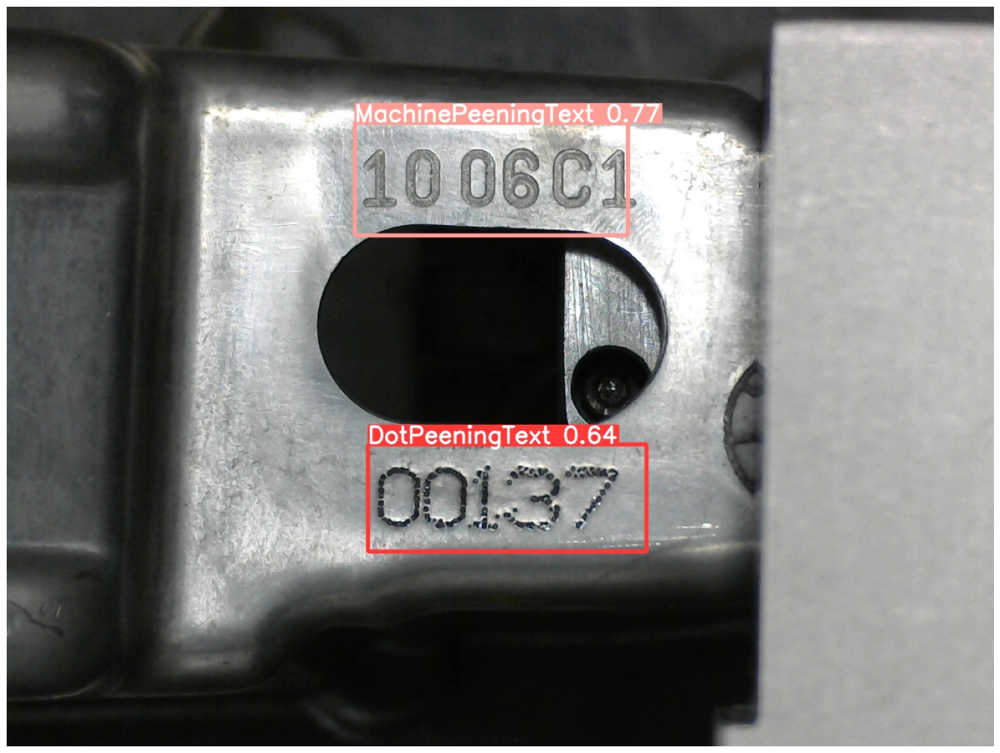

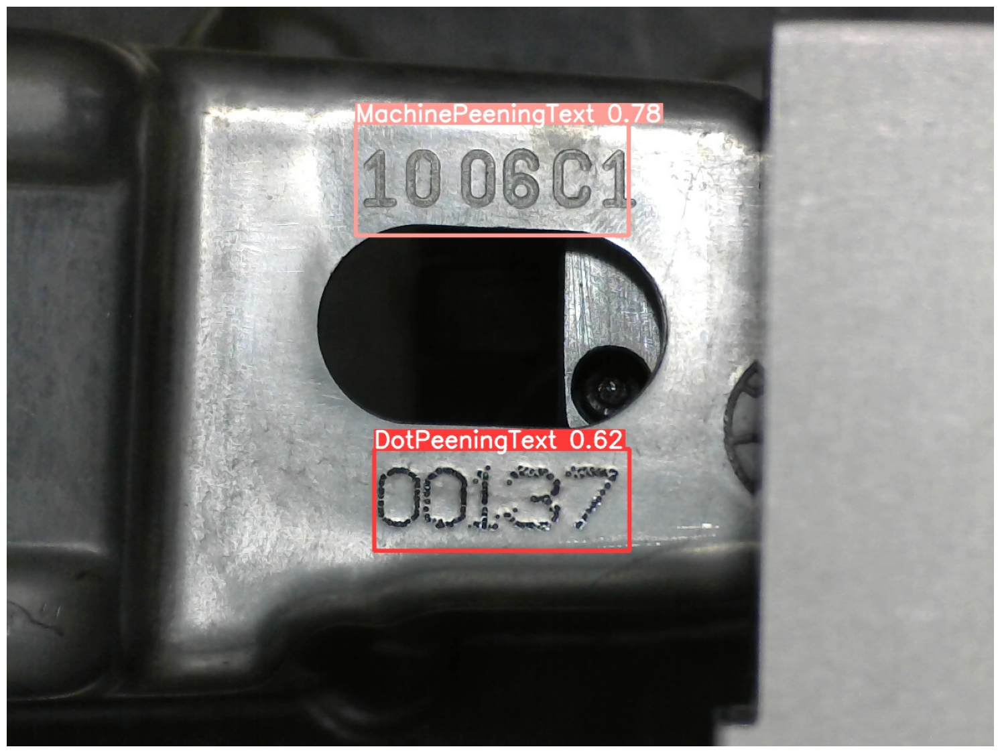

...

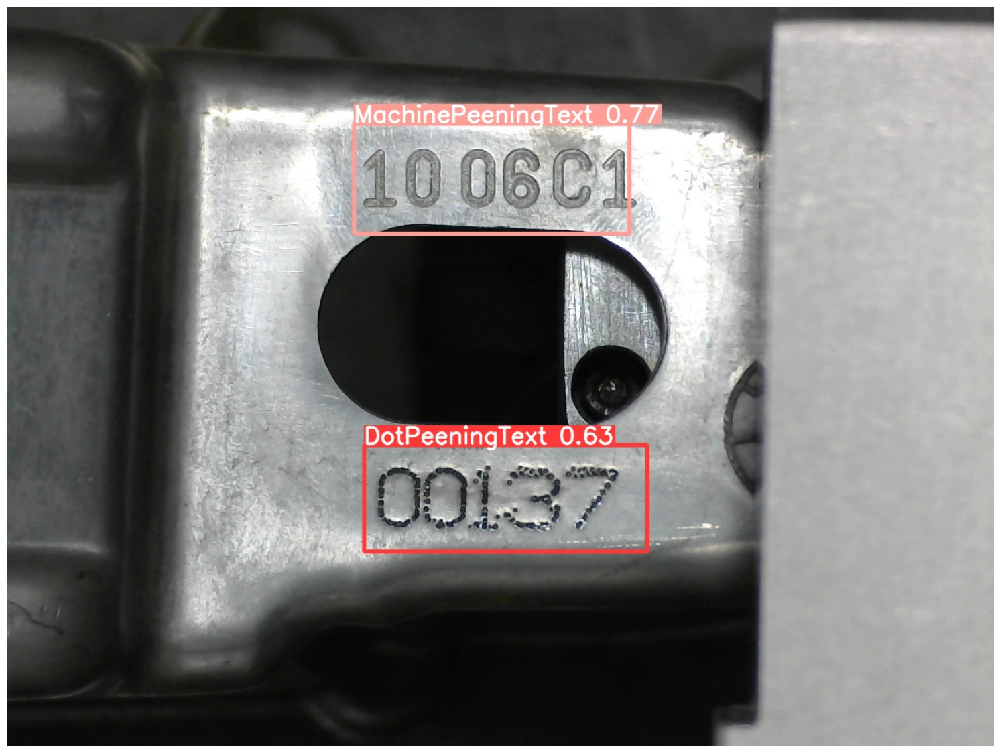

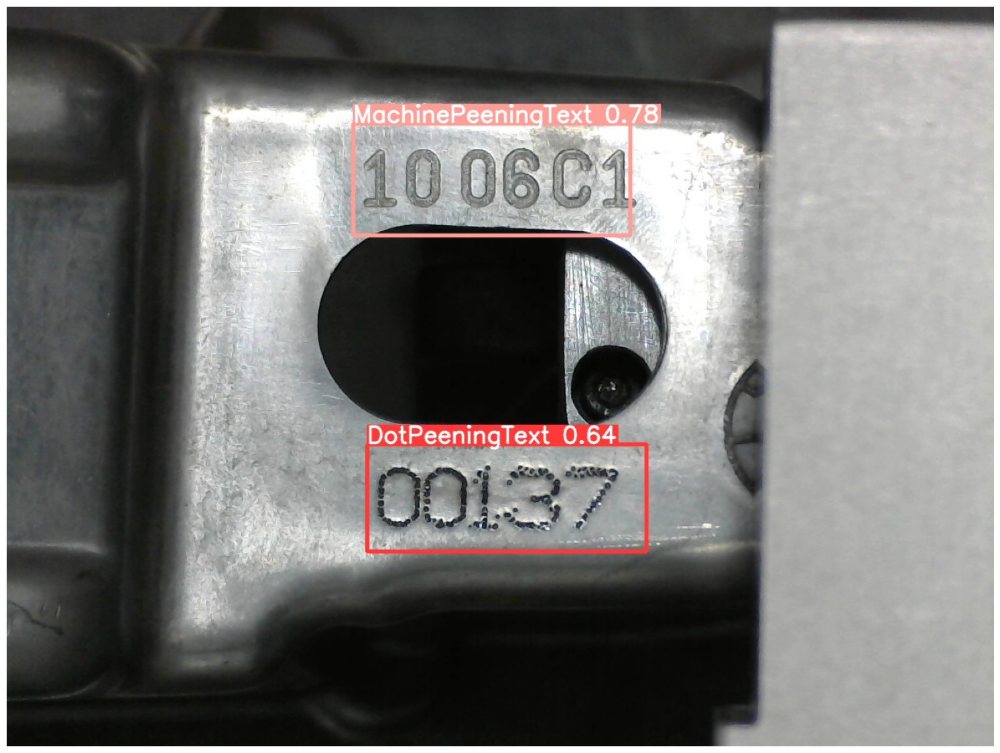

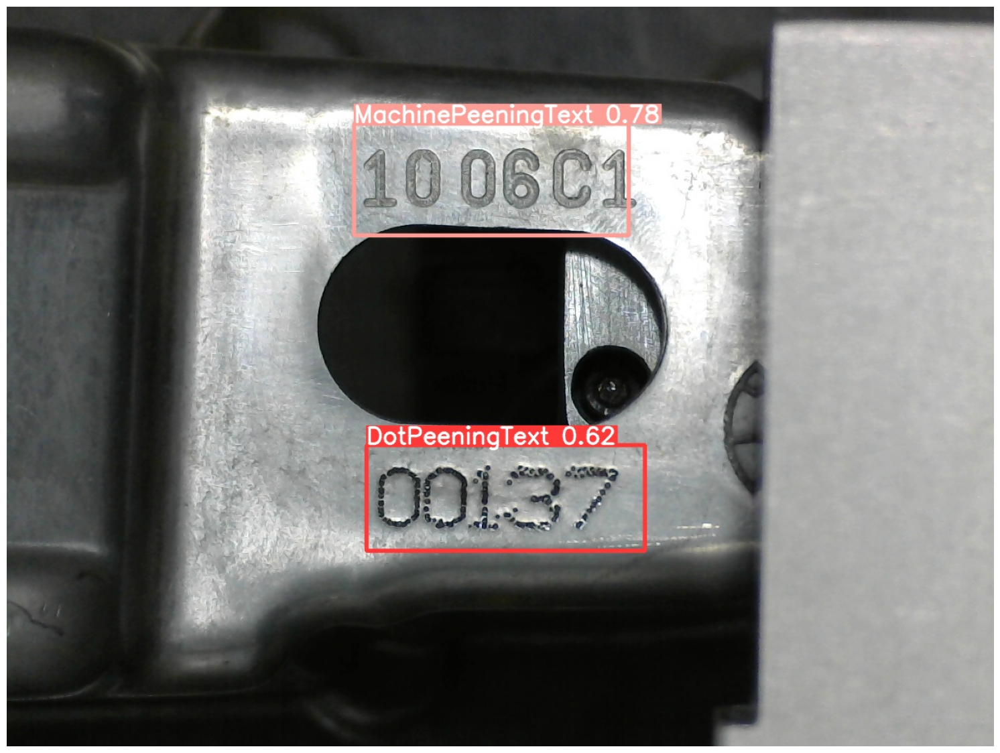

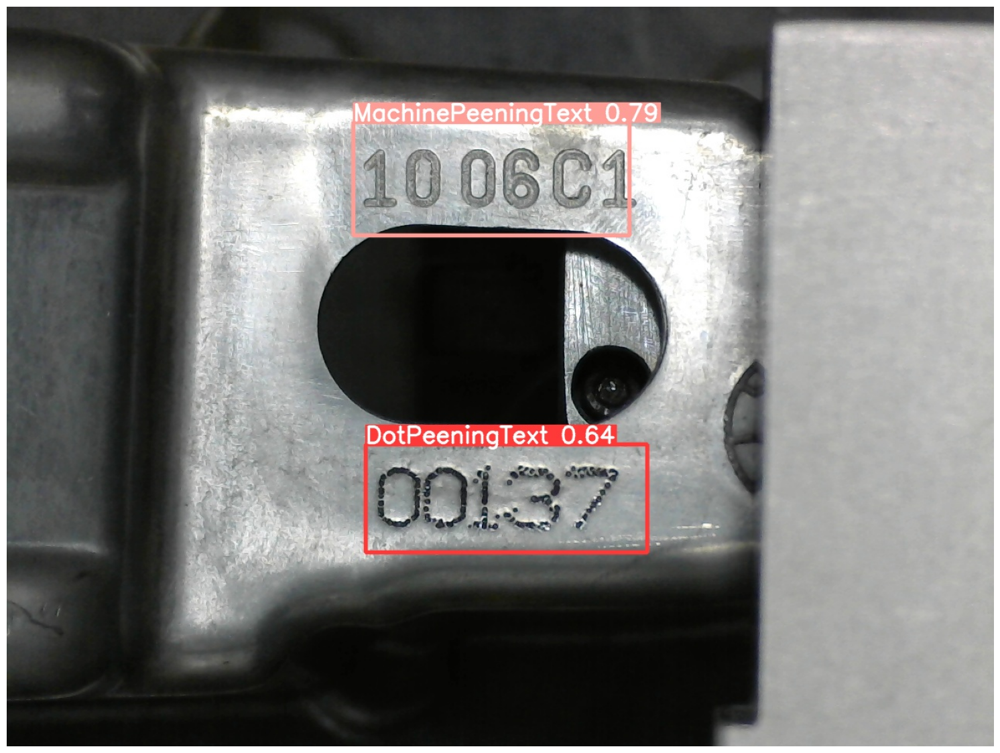

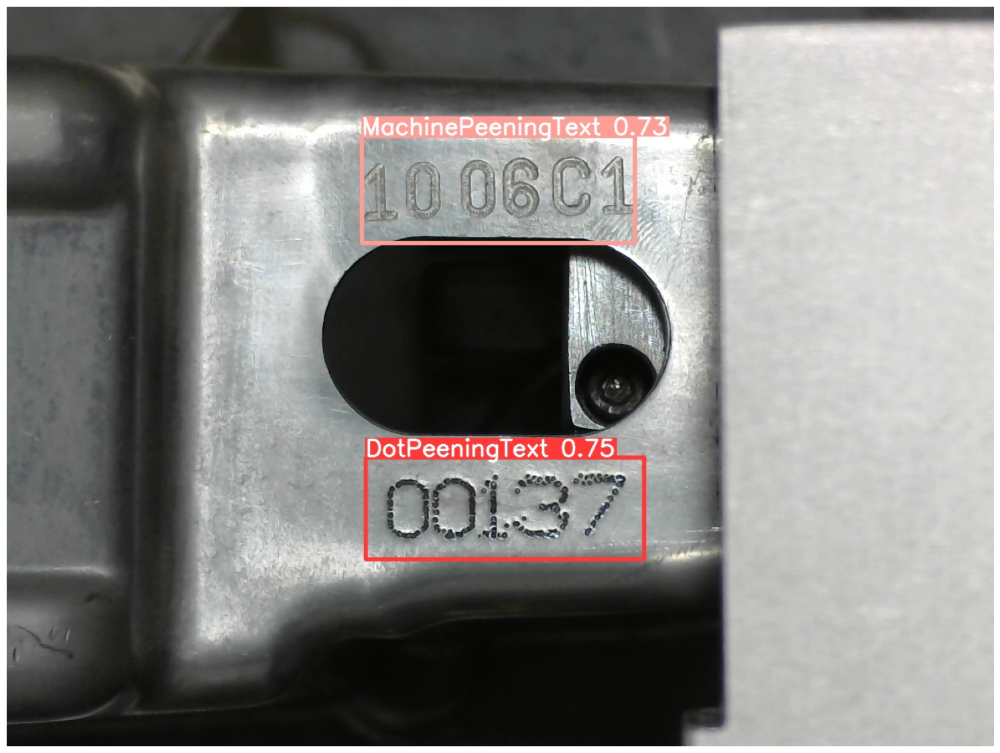

In [20]:
visualize(IMAGE_INFER_DIR)